<a href="https://colab.research.google.com/github/salmaannissa/PCVK-UAS-Kelompok7/blob/main/KELOMPOK_7_PCVK_MAIDY.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Import Library**

In [1]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import imutils
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import zipfile
import re
import cv2
import random
import os
from PIL import Image
import subprocess
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import load_model
from imutils.contours import sort_contours

**Sambungkan drive**

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **MNIST Creation Model**
**Load MNIST**

In [3]:
from tensorflow.keras.datasets import mnist

In [4]:
(train_data, train_labels), (test_data, test_labels) = mnist.load_data()

11490434/11490434 [==============================] - 1s 0us/step


In [5]:
# Check shape data
(train_data.shape, test_data.shape)

((60000, 28, 28), (10000, 28, 28))

In [6]:
# Check shape labels
(train_labels.shape, test_labels.shape)

((60000,), (10000,))

In [7]:
# Check each data shape --> should be 28*28
train_data[0].shape

(28, 28)

In [8]:
# Check the label
train_labels.shape

(60000,)

**Combine train and test data**

In [9]:
digits_data = np.vstack([train_data, test_data])
digits_labels = np.hstack([train_labels, test_labels])

In [10]:
# Check data shape
digits_data.shape

(70000, 28, 28)

In [11]:
# Check label shape
digits_labels.shape

(70000,)

Text(0.5, 1.0, 'Class: 4')

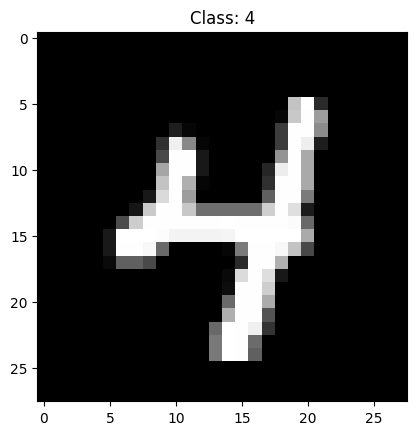

In [12]:
# Randomly checking the data
idx = np.random.randint(0, digits_data.shape[0])
plt.imshow(digits_data[idx], cmap='gray')
plt.title('Class: ' + str(digits_labels[idx]))

<Axes: xlabel='Labels', ylabel='count'>

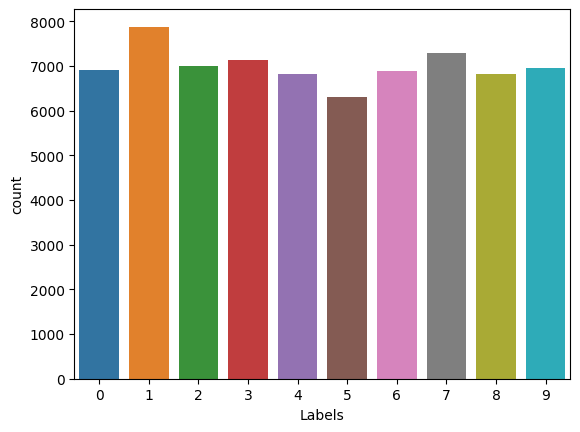

In [13]:
# Check data distribution
df_labels = pd.DataFrame(digits_labels, columns=['Labels'])
sns.countplot(df_labels, x='Labels')

**Load Kaggle A-Z**

In [14]:
!wget https://iaexpert.academy/arquivos/alfabeto_A-Z.zip

--2023-12-22 01:15:38--  https://iaexpert.academy/arquivos/alfabeto_A-Z.zip
Resolving iaexpert.academy (iaexpert.academy)... 162.159.134.42
Connecting to iaexpert.academy (iaexpert.academy)|162.159.134.42|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 193643888 (185M) [application/zip]
Saving to: ‘alfabeto_A-Z.zip’

alfabeto_A-Z.zip    100%[===================>] 184.67M   146MB/s    in 1.3s    

2023-12-22 01:15:39 (146 MB/s) - ‘alfabeto_A-Z.zip’ saved [193643888/193643888]



In [15]:
# Extract zip file
zip_object = zipfile.ZipFile(file = 'alfabeto_A-Z.zip', mode = 'r')
zip_object.extractall('./')
zip_object.close()

In [16]:
dataset_az = pd.read_csv('A_Z Handwritten Data.csv').astype('float32')
dataset_az

,0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,...,0.639,0.640,0.641,0.642,0.643,0.644,0.645,0.646,0.647,0.648
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372445,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372446,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372447,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372448,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [17]:
# Get pixel data only
alphabet_data = dataset_az.drop('0', axis=1)
# Get labels only
alphabet_labels = dataset_az['0']

In [18]:
# Check shape data
alphabet_data.shape, alphabet_labels.shape

((372450, 784), (372450,))

In [19]:
# Check shape labels
alphabet_labels.shape

(372450,)

In [20]:
# Reshape pixel data to 28*28
alphabet_data = np.reshape(alphabet_data.values, (alphabet_data.shape[0], 28, 28))
# Check the result by its shape
alphabet_data.shape

(372450, 28, 28)

Text(0.5, 1.0, 'Class: 0.0')

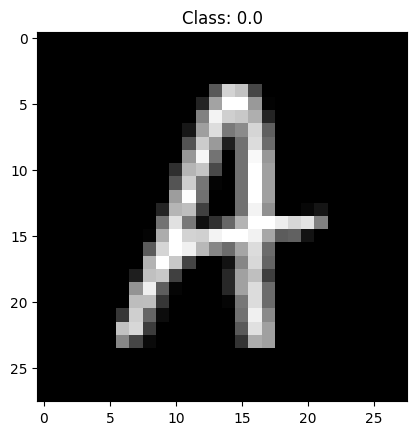

In [21]:
# Randomly checking A-Z dataset
index = np.random.randint(0, alphabet_data.shape[0])
plt.imshow(alphabet_data[index], cmap = 'gray')
plt.title('Class: ' + str(alphabet_labels[index]))

<Axes: xlabel='Labels', ylabel='count'>

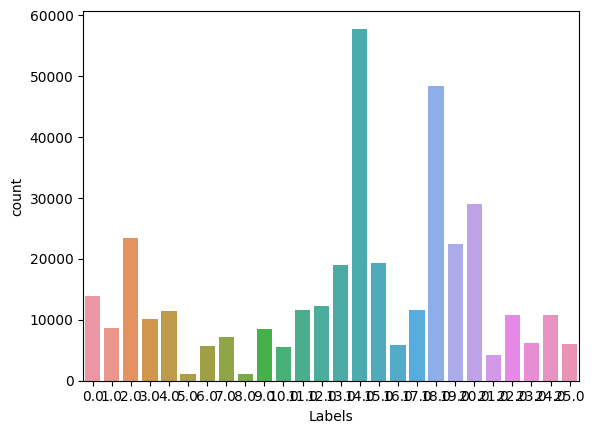

In [22]:
# Check data distribution
df_az_labels = pd.DataFrame({
    'Labels': alphabet_labels.values
})
sns.countplot(df_az_labels, x='Labels')

**Combine Dataset (MNIST + Kaggel A-Z)**

In [23]:
# Check unique value from digits_labels
np.unique(digits_labels)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8)

In [24]:
# Check unique value from alphabet_labels
np.unique(alphabet_labels)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.],
      dtype=float32)

In [25]:
# We already know that digits labels containt labels from 0-9 (10 labels)
# We also know that alphabet labels start from 0-25 which represent A-Z
# If we want to combine them, the A-Z labels should continuing the digits label

alphabet_labels += 10

In [26]:
# check alphabet labels again
np.unique(alphabet_labels)

array([10., 11., 12., 13., 14., 15., 16., 17., 18., 19., 20., 21., 22.,
       23., 24., 25., 26., 27., 28., 29., 30., 31., 32., 33., 34., 35.],
      dtype=float32)

In [27]:
# Combine both of them
data = np.vstack([alphabet_data, digits_data])
labels = np.hstack([alphabet_labels, digits_labels])

In [28]:
# Check the shape
data.shape, labels.shape

((442450, 28, 28), (442450,))

In [29]:
# Check labels
np.unique(labels)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
       26., 27., 28., 29., 30., 31., 32., 33., 34., 35.], dtype=float32)

In [30]:
# Convert data to float32
data = np.array(data, dtype = 'float32')

In [31]:
# Since Convolutional need 3d data (including depth)
# and our images only in 2d data (because in grayscale format)
# we need to add "the depth" to the data
data = np.expand_dims(data, axis=-1)

# check shape
data.shape

(442450, 28, 28, 1)

**Preprocessing**

In [32]:
# Normalize data
data /= 255.0

In [33]:
# Check range value of data
data[0].min(), data[0].max()

(0.0, 1.0)

In [34]:
# Enconde the labels
# LabelBinarizer similar with OneHotEncoder
le = LabelBinarizer()
labels = le.fit_transform(labels)

In [35]:
# Check labels shape
labels.shape

(442450, 36)

Text(0.5, 1.0, '[0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]')

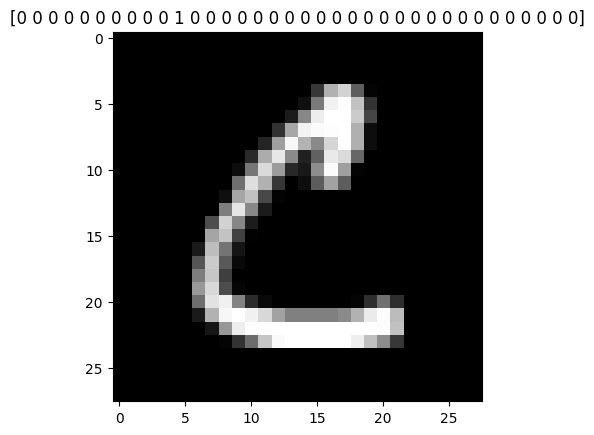

In [36]:
# Check data with label binarizer's label
plt.imshow(data[30000].reshape(28,28), cmap='gray')
plt.title(str(labels[0]))

In [37]:
# Since our data is not balance, we will handle it by giving weight for 'small' data

# Check number of data for each labels first
classes_total = labels.sum(axis = 0)
classes_total

array([ 6903,  7877,  6990,  7141,  6824,  6313,  6876,  7293,  6825,
        6958, 13869,  8668, 23409, 10134, 11440,  1163,  5762,  7218,
        1120,  8493,  5603, 11586, 12336, 19010, 57825, 19341,  5812,
       11566, 48419, 22495, 29008,  4182, 10784,  6272, 10859,  6076])

In [38]:
# Check the biggest value of data
classes_total.max()

57825

In [39]:
# Create a weight for each data
classes_weights = {}
for i in range(0, len(classes_total)):
  #print(i)
  classes_weights[i] = classes_total.max() / classes_total[i]

# Check the weight for each data
classes_weights

{0: 8.376792698826597,
 1: 7.340992763742541,
 2: 8.272532188841202,
 3: 8.097605377398123,
 4: 8.473769050410317,
 5: 9.15967052114684,
 6: 8.409685863874346,
 7: 7.928835870012341,
 8: 8.472527472527473,
 9: 8.310577752227651,
 10: 4.169370538611291,
 11: 6.671089063221043,
 12: 2.4702037677816224,
 13: 5.7060390763765545,
 14: 5.0546328671328675,
 15: 49.72055030094583,
 16: 10.035577924331829,
 17: 8.011221945137157,
 18: 51.629464285714285,
 19: 6.808548216178029,
 20: 10.320364090665715,
 21: 4.990937338166753,
 22: 4.6875,
 23: 3.0418200946870066,
 24: 1.0,
 25: 2.989762680316426,
 26: 9.94924294562973,
 27: 4.999567698426422,
 28: 1.1942625828703608,
 29: 2.5705712380529007,
 30: 1.993415609487038,
 31: 13.827116212338593,
 32: 5.362110534124629,
 33: 9.21954719387755,
 34: 5.3250759738465785,
 35: 9.51695194206715}

**Split Data to Train and Test**

In [40]:
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size = 0.2, random_state = 1, stratify = labels)

**Create Data Augmentation**

In [41]:
# Import library
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [42]:
augmentation = ImageDataGenerator(rotation_range = 10, zoom_range=0.05, width_shift_range=0.1,
                                  height_shift_range=0.1, horizontal_flip = False)

**Build CNN Model**

In [43]:
# Import library
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPool2D, Flatten, Dense
from tensorflow.keras.callbacks import ModelCheckpoint

In [44]:
# Build the network
network = Sequential()

network.add(Conv2D(filters = 32, kernel_size=(3,3), activation='relu', input_shape=(28,28,1)))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Conv2D(filters = 64, kernel_size=(3,3), activation='relu', padding='same'))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Conv2D(filters = 128, kernel_size=(3,3), activation='relu', padding='valid'))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Flatten())

network.add(Dense(64, activation = 'relu'))
network.add(Dense(128, activation = 'relu'))

# output
network.add(Dense(36, activation='softmax'))

network.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

In [45]:
# Check network summary
network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 13, 13, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 128)         73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 2, 2, 128)         0

In [46]:
# Create actual labels
name_labels = '0123456789'
name_labels += 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'
name_labels = [l for l in name_labels]

# Check actual label
print(name_labels)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


In [47]:
import joblib

joblib.dump(name_labels, "labels.pkl")

['labels.pkl']

In [48]:
a = joblib.load("labels.pkl")
print(a)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


**Train model**

In [49]:
# Set model name, epoch, and batch size
file_model = 'custom_ocr.model'
epochs = 20
batch_size = 128

In [50]:
# Setup checkpoint
checkpointer = ModelCheckpoint(file_model, monitor = 'val_loss', verbose = 1, save_best_only=True)

In [51]:
# Fit the model
history = network.fit(augmentation.flow(X_train, y_train, batch_size=batch_size),
                      validation_data = (X_test, y_test),
                      steps_per_epoch = len(X_train) // batch_size, epochs=epochs,
                      class_weight = classes_weights, verbose=1, callbacks=[checkpointer])

Epoch 1/20
2764/2765 [============================>.] - ETA: 0s - loss: 2.2160 - accuracy: 0.8235
Epoch 1: val_loss improved from inf to 0.26615, saving model to custom_ocr.model
2765/2765 [==============================] - 156s 54ms/step - loss: 2.2157 - accuracy: 0.8236 - val_loss: 0.2661 - val_accuracy: 0.9080
Epoch 2/20
2765/2765 [==============================] - ETA: 0s - loss: 0.9754 - accuracy: 0.9022
Epoch 2: val_loss improved from 0.26615 to 0.25399, saving model to custom_ocr.model
2765/2765 [==============================] - 140s 50ms/step - loss: 0.9754 - accuracy: 0.9022 - val_loss: 0.2540 - val_accuracy: 0.8934
Epoch 3/20
2765/2765 [==============================] - ETA: 0s - loss: 0.8077 - accuracy: 0.9138
Epoch 3: val_loss did not improve from 0.25399
2765/2765 [==============================] - 144s 52ms/step - loss: 0.8077 - accuracy: 0.9138 - val_loss: 0.2875 - val_accuracy: 0.8652
Epoch 4/20
2765/2765 [==============================] - ETA: 0s - loss: 0.7189 - accu

**Save and load The Model**

In [53]:
# The result will show in colab directory
save_path ='/content/drive/MyDrive/SEMESTER5/PCVK/dataset/model/network.h5'
network.save(save_path)

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [55]:
save_path = '/content/drive/MyDrive/SEMESTER5/PCVK/dataset/model/network.h5'
load_network = load_model(save_path)


**Evaluate Model - Make a Single Prediction**

In [56]:
# make a prediction
predictions = load_network.predict(X_test, batch_size=batch_size)

692/692 [==============================] - 2s 3ms/step


In [57]:
# Check prediction for data-0
# You will get the probability for each label
# The highest one is the prediction
predictions[10]

array([1.61267820e-07, 1.46562218e-09, 1.60314571e-08, 1.89716484e-05,
       7.27843397e-10, 3.63223329e-02, 3.83729503e-06, 1.50037422e-07,
       2.37581208e-08, 2.27841883e-06, 7.92173705e-12, 1.34814675e-08,
       1.93436972e-06, 8.58403215e-09, 7.19351467e-10, 7.75621566e-19,
       7.28726329e-04, 4.88212552e-12, 2.38797302e-16, 1.40306278e-04,
       3.16340953e-10, 1.38681697e-08, 2.23204552e-10, 6.98358882e-09,
       1.99392871e-05, 5.10342907e-13, 2.10812345e-08, 8.14317147e-15,
       9.62759018e-01, 6.13494819e-07, 1.92106042e-09, 1.33184249e-13,
       1.91593928e-11, 3.43664931e-16, 1.55452312e-06, 4.61538896e-08],
      dtype=float32)

In [58]:
# Get the actual prediction -> highest probability
np.argmax(predictions[10])

28

In [59]:
# Check label for 24
name_labels[28]

'S'

In [60]:
# Check y_test label for 0
y_test[10]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0])

In [61]:
# check the highest value
np.argmax(y_test[10])

28

In [62]:
# Check the label of y_test 0
name_labels[np.argmax(y_test[10])]

'S'

**Evaluate Model - Make an Evaluation on Test Data**

In [63]:
# Evaluate on test data
load_network.evaluate(X_test, y_test)

2766/2766 [==============================] - 9s 3ms/step - loss: 0.1774 - accuracy: 0.9350


[0.17741122841835022, 0.9350095987319946]

In [64]:
# Print Classification Report
print(classification_report(y_test.argmax(axis=1), predictions.argmax(axis=1), target_names = name_labels))

              precision    recall  f1-score   support

           0       0.34      0.64      0.44      1381
           1       0.97      0.99      0.98      1575
           2       0.90      0.96      0.93      1398
           3       0.94      0.99      0.97      1428
           4       0.93      0.97      0.95      1365
           5       0.40      0.96      0.56      1263
           6       0.96      0.97      0.96      1375
           7       0.94      0.99      0.96      1459
           8       0.95      0.99      0.97      1365
           9       0.98      0.97      0.97      1392
           A       0.99      0.99      0.99      2774
           B       0.98      0.98      0.98      1734
           C       0.99      0.98      0.99      4682
           D       0.90      0.97      0.94      2027
           E       0.99      0.99      0.99      2288
           F       0.95      1.00      0.98       233
           G       0.96      0.95      0.96      1152
           H       0.96    

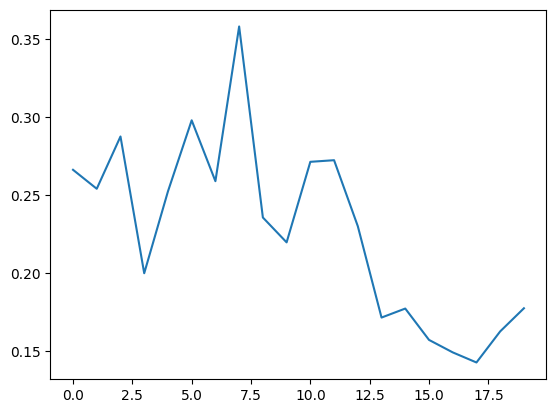

In [65]:
# Visualize loss value for each epoch
plt.plot(history.history['val_loss'])

In [66]:
# You can also check the another metrics
history.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

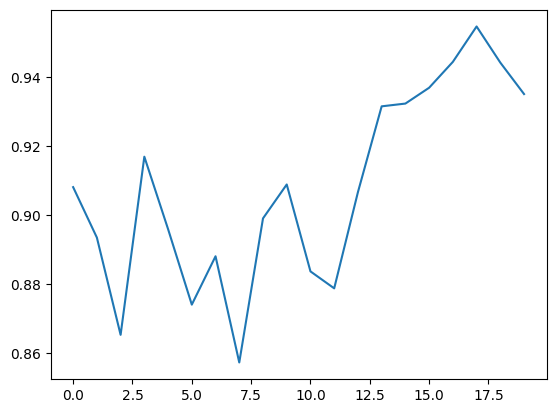

In [67]:
# Check the model performance by validation accuracy
plt.plot(history.history['val_accuracy'])

**Testing on Real Image**

# **Character Recognition**

In [69]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import imutils
from imutils.contours import sort_contours

In [70]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [71]:
image_path = [
    '/content/drive/MyDrive/SEMESTER5/PCVK/data/3D_2141720239_1-MUHAMADRAFIPRABOWO.jpeg',
    '/content/drive/MyDrive/SEMESTER5/PCVK/data/3D_2141720239_2-MUHAMADRAFIPRABOWO.jpg',
    '/content/drive/MyDrive/SEMESTER5/PCVK/data/3D_2141720239_3-MUHAMADRAFIPRABOWO.jpg',
    '/content/drive/MyDrive/SEMESTER5/PCVK/data/3D_2141720239_4-MUHAMADRAFIPRABOWO.jpg',
    '/content/drive/MyDrive/SEMESTER5/PCVK/data/3D_2141720239_5-MUHAMADRAFIPRABOWO.jpg',


]

In [72]:
# Define a kernel for morphological operations
kernel = np.ones((5, 5), np.uint8)

**Crop Image**

Cropped image saved at: /content/drive/MyDrive/SEMESTER5/PCVK/Kelompok5/cropped_images/cropped_3D_2141720239_1-MUHAMADRAFIPRABOWO.jpeg


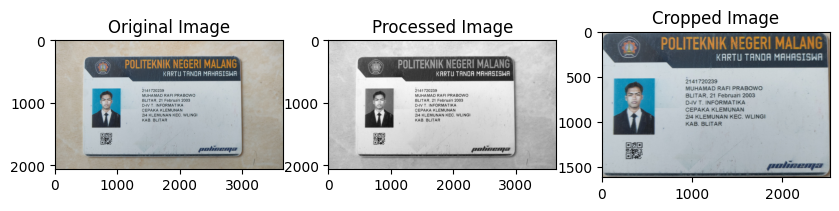

Cropped image saved at: /content/drive/MyDrive/SEMESTER5/PCVK/Kelompok5/cropped_images/cropped_3D_2141720239_2-MUHAMADRAFIPRABOWO.jpg


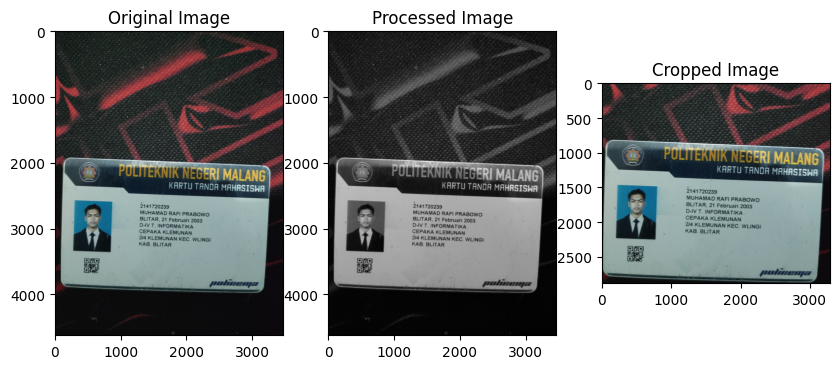

Cropped image saved at: /content/drive/MyDrive/SEMESTER5/PCVK/Kelompok5/cropped_images/cropped_3D_2141720239_3-MUHAMADRAFIPRABOWO.jpg


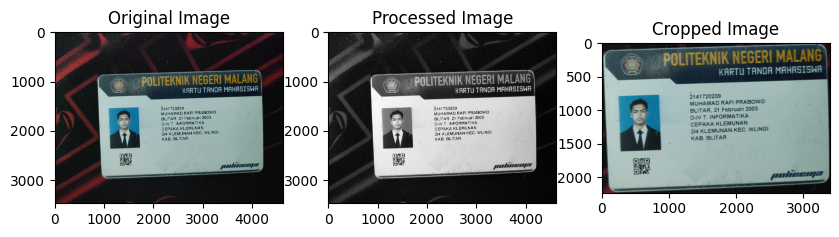

Cropped image saved at: /content/drive/MyDrive/SEMESTER5/PCVK/Kelompok5/cropped_images/cropped_3D_2141720239_4-MUHAMADRAFIPRABOWO.jpg


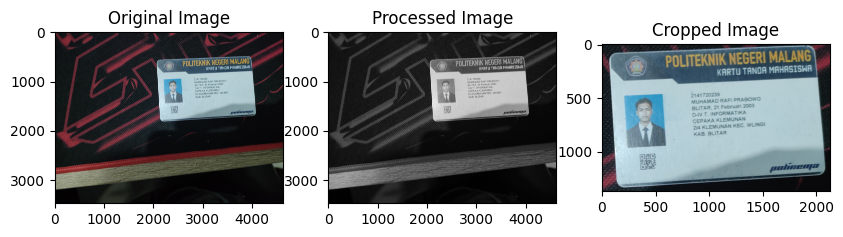

Cropped image saved at: /content/drive/MyDrive/SEMESTER5/PCVK/Kelompok5/cropped_images/cropped_3D_2141720239_5-MUHAMADRAFIPRABOWO.jpg


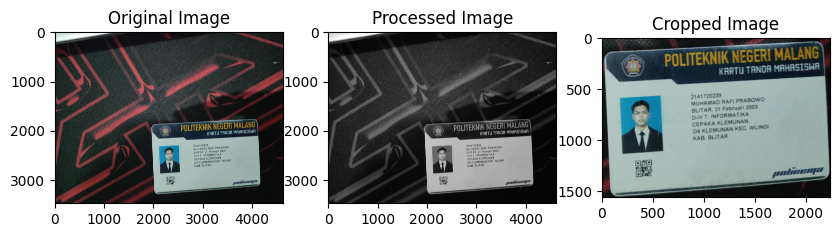

In [73]:

def load_image(image_path):
    return cv2.imread(image_path)

def preprocess_image(image):
    if image is None:
        print("Error: Image is not loaded.")
        return None

    # mengubah image menjadi grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # menggunakan GaussianBlur untuk mengurangi noise
    blur = cv2.GaussianBlur(gray, (5,5), 0)
    blur = cv2.GaussianBlur(blur, (5,5), 0)
    blur = cv2.GaussianBlur(blur, (5,5), 0)
    blur = cv2.GaussianBlur(blur, (5,5), 0)

    return blur

def localization(image):
    kernel = np.ones((5, 5), np.uint8)  # Define a kernel for morphological operations

    edged = cv2.Canny(image, 30, 50)

    dilate = cv2.dilate(edged, kernel, iterations=2)
    opening = cv2.morphologyEx(dilate, cv2.MORPH_OPEN, kernel)
    opening = cv2.morphologyEx(opening, cv2.MORPH_OPEN, kernel)

    contours, hierarchy = cv2.findContours(opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

    return contours

def cropped(image, contours):
    # Find object with the biggest bounding box
    mx = (0,0,0,0)      # biggest bounding box so far
    mx_area = 0
    for cont in contours:
        x, y, w, h = cv2.boundingRect(cont)
        area = w * h
        if area > mx_area:
            mx = x, y, w, h
            mx_area = area
    x, y, w, h = mx

    # Check if the cropping region is valid
    if w > 0 and h > 0:
        # Crop and save
        cropped = image[y:y+h, x:x+w]
        return cropped
    else:
        print("Error: Invalid cropping region.")
        return None



# Folder to save cropped images
cropped_folder = "/content/drive/MyDrive/SEMESTER5/PCVK/Kelompok5/cropped_images"


# Loop through all images in the folder
for image_path in image_path:
    # Load image
    image = cv2.imread(image_path)

    if image is not None:
        # Preprocess image
        processed_image = preprocess_image(image)

        # Get contours
        contours = localization(processed_image)

        # Crop the image
        cropped_image = cropped(image, contours)

        # Display the original image, processed image, and cropped image using matplotlib
        plt.figure(figsize=(10, 7))

        plt.subplot(131)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')

        plt.subplot(132)
        plt.imshow(processed_image, cmap='gray')
        plt.title('Processed Image')

        if cropped_image is not None:
            plt.subplot(133)
            plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
            plt.title('Cropped Image')

            # Save the cropped image
            filename = os.path.join(cropped_folder, "cropped_" + os.path.basename(image_path))
            cv2.imwrite(filename, cropped_image)
            print("Cropped image saved at:", filename)

        plt.show()


In [74]:
def preprocess_image(image_path):
    img = cv2.imread(image_path)
    # Display the original image
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('off')

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    plt.subplot(2, 3, 2)
    plt.imshow(gray, cmap='gray')
    plt.title('Grayscale')
    plt.axis('off')

    # Apply Gaussian Blur
    blur = cv2.GaussianBlur(gray, (3, 3), 0)
    plt.subplot(2, 3, 3)
    plt.imshow(blur, cmap='gray')
    plt.title('Gaussian Blur')
    plt.axis('off')

    # Apply Adaptive Threshold
    adaptive = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 9)
    plt.subplot(2, 3, 4)
    plt.imshow(adaptive, cmap='gray')
    plt.title('Adaptive Threshold')
    plt.axis('off')

    # Invert the image
    invertion = 255 - adaptive
    plt.subplot(2, 3, 5)
    plt.imshow(invertion, cmap='gray')
    plt.title('Inverted Image')
    plt.axis('off')

    # Dilate the image
    dilation = cv2.dilate(invertion, np.ones((3, 3)))
    plt.subplot(2, 3, 6)
    plt.imshow(dilation, cmap='gray')
    plt.title('Dilated Image')
    plt.axis('off')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

    return img, gray, dilation

# KTM 1 RAFI

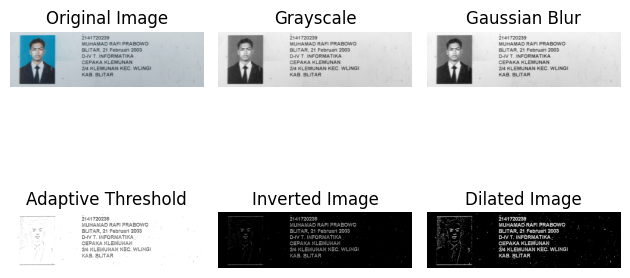

In [78]:
# Call the function with the image path
image_path = '/content/drive/MyDrive/SEMESTER5/PCVK/data/crop/3D_2141720239_1-MUHAMAD RAFI PRABOWO.jpeg'
img, gray, dilation = preprocess_image(image_path)

In [79]:
# Define function for contour detection
def find_contours(img):
    conts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    conts = imutils.grab_contours(conts)
    conts = sort_contours(conts, method='left-to-right')[0]

    return conts

In [80]:
conts = find_contours(dilation.copy())

In [81]:
len(conts)

1235

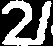

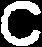

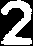

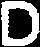

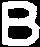

...

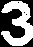

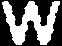

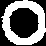

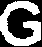

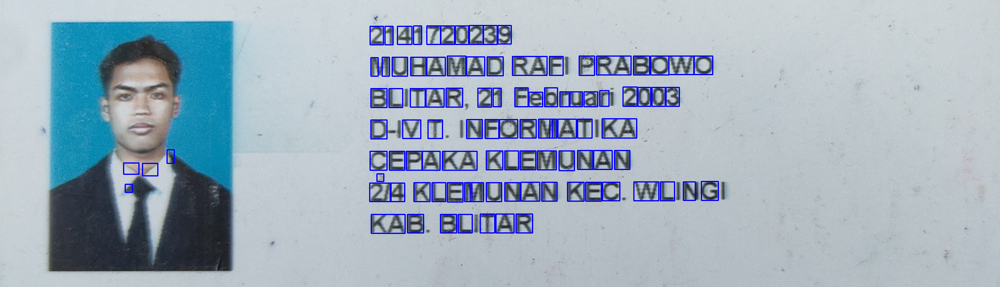

In [82]:
# Get the char based on contour


# Setup min/max width/hight for char
min_w, max_w = 17, 160
min_h, max_h = 19, 140
img_copy = img.copy() # original image for plotting countour result
filtered_conts = []

for c in conts:
  (x, y, w, h) = cv2.boundingRect(c) # find bounding box based on contour
  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h): # if pixel follow this rule, it consider as char
    filtered_conts.append(c)
    roi = gray[y:y+h, x:x+w] # get region of interest for char
    thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    cv2_imshow(thresh) # check

    # Build bounding box on original image
    cv2.rectangle(img_copy, (x,y), (x+w, y+h), (255,0,0), 2)

# Show bounding box on original image
cv2_imshow(img_copy)

In [83]:
def extract_roi(img, margin=2):
  roi = img[y - margin:y+h, x - margin:x + w + margin]
  return roi

# Thresholding
def thresholding(img):
  thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
  return thresh

# Resizing
def resize_img(img, w, h):
  if w > h:
    resized = imutils.resize(img, width=28)
  else:
    resized = imutils.resize(img, height=28)

  # (w, h) = resized.shape
  (h, w) = resized.shape

  # Calculate how many pixels need to fill char image
  dX = int(max(0, 28 - w) / 2.0)
  dY = int(max(0, 28 - h) / 2.0)

  filled = cv2.copyMakeBorder(resized, top=dY, bottom=dY, right=dX, left=dX, borderType=cv2.BORDER_CONSTANT, value=(0,0,0))
  filled = cv2.resize(filled, (28,28))

  return filled

In [84]:
# Demo for enlarge
(x, y, w, h) = cv2.boundingRect(filtered_conts[2])
test_image = thresholding(gray[y:y+h, x:x+w])

# show original test image
cv2_imshow(test_image)

# Show enlarge test image
cv2_imshow(cv2.resize(test_image, (28,28)))

In [85]:
(h, w) = test_image.shape

test_image2 = resize_img(test_image, w, h)

cv2_imshow(test_image)
cv2_imshow(test_image2)

In [86]:
def normalization(img):
  img = img.astype('float32') / 255.0 # convert to floating point
  img = np.expand_dims(img, axis=-1) # add depth
  return img

In [87]:
# Check
test_image2.shape, normalization(test_image2).shape

((28, 28), (28, 28, 1))

# DETECTION

In [88]:
def process_box(gray, x, y, w, h):

  roi = extract_roi(gray)
  thresh = thresholding(roi)
  (h, w) = thresh.shape
  resized = resize_img(thresh, w, h)

  # show result
  cv2_imshow(resized)

  normalized = normalization(resized)

  return (normalized, (x, y, w, h))

**ROI extraction**

In [89]:
# Detect every single char from contour
detected_char = []

for c in conts:
  (x, y, w, h ) = cv2.boundingRect(c)

  min_w, max_w = 17, 160
  min_h, max_h = 19, 140

  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h):
    detected_char.append(process_box(gray, x, y, w, h))

In [90]:
detected_char[0][1]

(307, 405, 42, 30)

In [91]:
# Get all char pixel
pixels = np.array([px[0] for px in detected_char], dtype='float32')

# Get all box for detected char
boxes = [box[1] for box in detected_char]

In [92]:
pixels.shape

(99, 28, 28, 1)

# RECOGNIZE CHAR

In [93]:
digits = '0123456789'
letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
char_list = digits + letters
char_list = [ch for ch in char_list]

print(char_list)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']


In [94]:
save_path = '/content/drive/MyDrive/SEMESTER5/PCVK/dataset/model/network.h5'
load_network = load_model(save_path)

In [95]:
# Predict
preds = load_network.predict(pixels)

4/4 [==============================] - 0s 69ms/step


In [96]:
# Char Prediction
for p in preds:
  char_idx = np.argmax(p)
  print(char_list[char_idx], end = " ")

4 1 P T U C 2 D B A M B A 9 L E A U 4 V P B T H 9 K A A A 7 T L B 2 M R E M 0 L N N A 2 H 2 T 3 F U K D 3 A 9 O N L R F R E R A E M H N D F O A U T K U N T P 2 E A M K M C N 2 B W 0 0 0 L 3 W N 0 G 

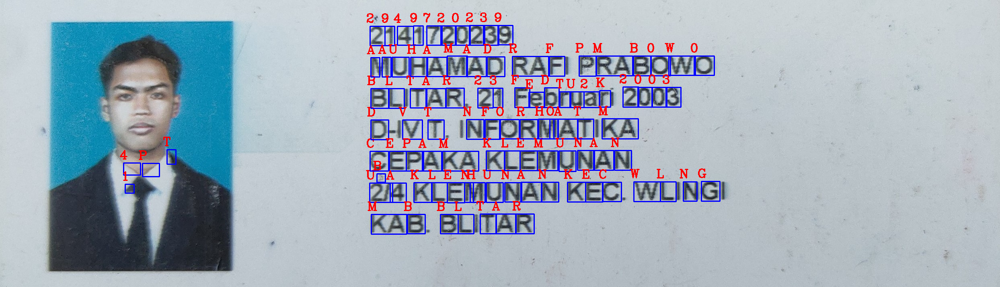

In [97]:
# Show char with actual image
img_copy2 = img.copy()

for(pred, (x, y, w, h)) in zip(preds, boxes):
  i = np.argmax(pred)
  char_detected = char_list[i]

  cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (255,0,0), 2)
  cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (0,0,255), 2)

cv2_imshow(img_copy2)

# KTM 2 RAFI

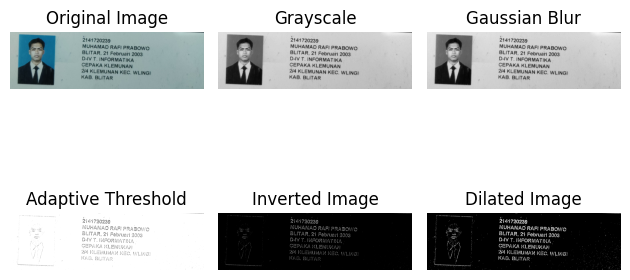

In [98]:
# Call the function with the image path
image_path = '/content/drive/MyDrive/SEMESTER5/PCVK/data/crop/3D_2141720239_2-MUHAMAD RAFI PRABOWO.jpg'
img, gray, dilation = preprocess_image(image_path)

In [99]:
# Define function for contour detection
def find_contours(img):
    conts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    conts = imutils.grab_contours(conts)
    conts = sort_contours(conts, method='left-to-right')[0]

    return conts

In [100]:
conts = find_contours(dilation.copy())

In [101]:
len(conts)

1464

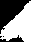

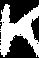

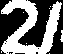

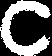

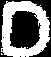

...

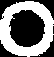

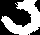

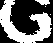

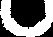

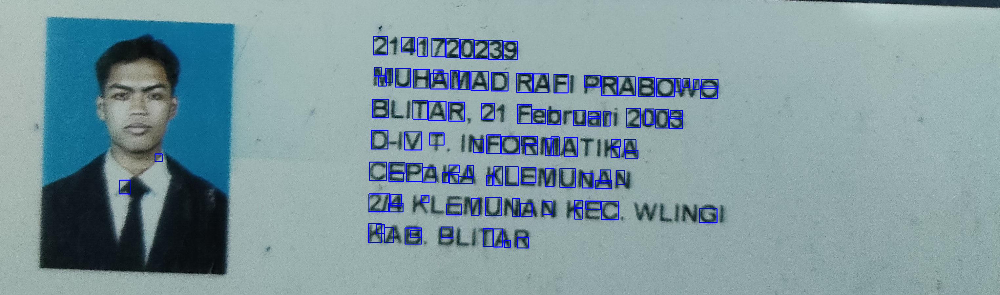

In [102]:
# Get the char based on contour


# Setup min/max width/hight for char
min_w, max_w = 17, 160
min_h, max_h = 19, 140
img_copy = img.copy() # original image for plotting countour result
filtered_conts = []

for c in conts:
  (x, y, w, h) = cv2.boundingRect(c) # find bounding box based on contour
  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h): # if pixel follow this rule, it consider as char
    filtered_conts.append(c)
    roi = gray[y:y+h, x:x+w] # get region of interest for char
    thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    cv2_imshow(thresh) # check

    # Build bounding box on original image
    cv2.rectangle(img_copy, (x,y), (x+w, y+h), (255,0,0), 2)

# Show bounding box on original image
cv2_imshow(img_copy)

In [103]:
def extract_roi(img, margin=2):
  roi = img[y - margin:y+h, x - margin:x + w + margin]
  return roi

# Thresholding
def thresholding(img):
  thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
  return thresh

# Resizing
def resize_img(img, w, h):
  if w > h:
    resized = imutils.resize(img, width=28)
  else:
    resized = imutils.resize(img, height=28)

  # (w, h) = resized.shape
  (h, w) = resized.shape

  # Calculate how many pixels need to fill char image
  dX = int(max(0, 28 - w) / 2.0)
  dY = int(max(0, 28 - h) / 2.0)

  filled = cv2.copyMakeBorder(resized, top=dY, bottom=dY, right=dX, left=dX, borderType=cv2.BORDER_CONSTANT, value=(0,0,0))
  filled = cv2.resize(filled, (28,28))

  return filled

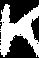

In [104]:
# Demo for enlarge
(x, y, w, h) = cv2.boundingRect(filtered_conts[2])
test_image = thresholding(gray[y:y+h, x:x+w])

# show original test image
cv2_imshow(test_image)

# Show enlarge test image
cv2_imshow(cv2.resize(test_image, (28,28)))

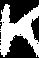

In [105]:
(h, w) = test_image.shape

test_image2 = resize_img(test_image, w, h)

cv2_imshow(test_image)
cv2_imshow(test_image2)

In [106]:
def normalization(img):
  img = img.astype('float32') / 255.0 # convert to floating point
  img = np.expand_dims(img, axis=-1) # add depth
  return img

In [107]:
# Check
test_image2.shape, normalization(test_image2).shape

((28, 28), (28, 28, 1))

# DETECTION

In [108]:
def process_box(gray, x, y, w, h):

  roi = extract_roi(gray)
  thresh = thresholding(roi)
  (h, w) = thresh.shape
  resized = resize_img(thresh, w, h)

  # show result
  cv2_imshow(resized)

  normalized = normalization(resized)

  return (normalized, (x, y, w, h))

In [109]:
# Detect every single char from contour
detected_char = []

for c in conts:
  (x, y, w, h ) = cv2.boundingRect(c)

  min_w, max_w = 17, 160
  min_h, max_h = 19, 140

  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h):
    detected_char.append(process_box(gray, x, y, w, h))

In [110]:
detected_char[0][1]

(364, 549, 36, 44)

In [111]:
# Get all char pixel
pixels = np.array([px[0] for px in detected_char], dtype='float32')

# Get all box for detected char
boxes = [box[1] for box in detected_char]

In [112]:
pixels.shape

(112, 28, 28, 1)

# RECOGNIZE CHAR

In [113]:
digits = '0123456789'
letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
char_list = digits + letters
char_list = [ch for ch in char_list]

print(char_list)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']


In [114]:
save_path = '/content/drive/MyDrive/SEMESTER5/PCVK/dataset/model/network.h5'
load_network = load_model(save_path)

In [115]:
# Predict
preds = load_network.predict(pixels)

4/4 [==============================] - 0s 68ms/step


In [116]:
# Char Prediction
for p in preds:
  char_idx = np.argmax(p)
  print(char_list[char_idx], end = " ")

A P K U C D B 2 B P Y L B 4 E E A U B V B P 2 T H 7 A A A T A T R 2 8 2 E R 1 1 A U 1 0 3 A U V 2 7 T U 8 F 3 D L 1 O 9 Y L U R T F B F O Y E A A U V D A F U A U 1 H V D C O 2 M A C R K Y E A A A M 2 B 7 0 O S 3 1 3 1 G U N 

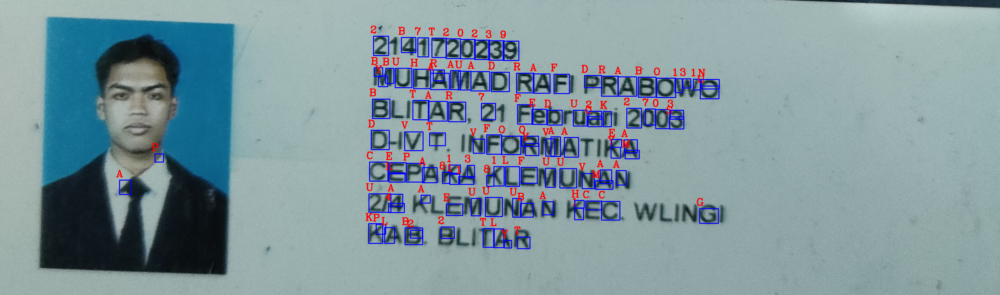

In [118]:
# Show char with actual image
img_copy2 = img.copy()

for(pred, (x, y, w, h)) in zip(preds, boxes):
  i = np.argmax(pred)
  char_detected = char_list[i]

  cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (255,0,0), 2)
  cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (0,0,255), 2)

cv2_imshow(img_copy2)

# KTM 3 RAFI

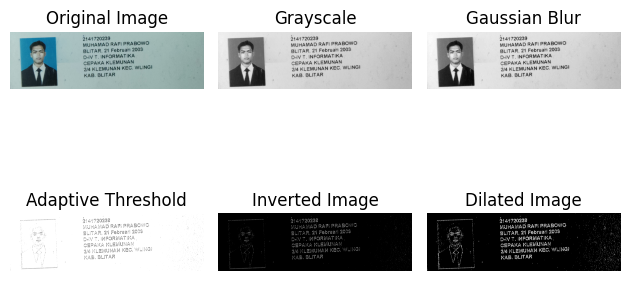

In [119]:
# Call the function with the image path
image_path = '/content/drive/MyDrive/SEMESTER5/PCVK/data/crop/3D_2141720239_3-MUHAMAD RAFI PRABOWO.jpg'
img, gray, dilation = preprocess_image(image_path)

In [120]:
# Define function for contour detection
def find_contours(img):
    conts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    conts = imutils.grab_contours(conts)
    conts = sort_contours(conts, method='left-to-right')[0]

    return conts

In [121]:
conts = find_contours(dilation.copy())

In [122]:
len(conts)

2743

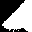

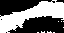

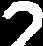

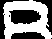

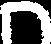

...

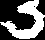

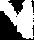

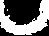

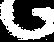

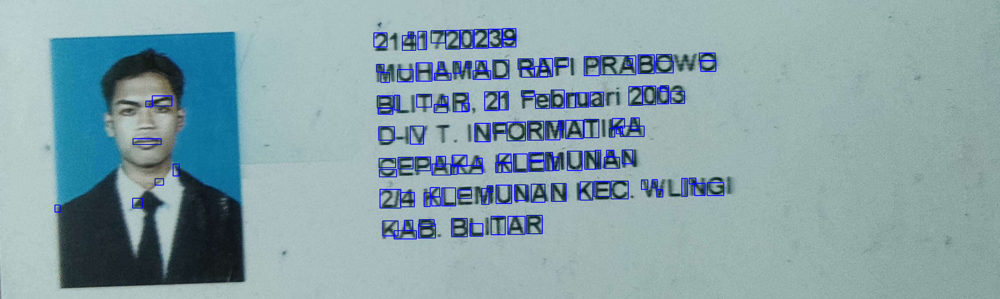

In [123]:
# Get the char based on contour


# Setup min/max width/hight for char
min_w, max_w = 17, 160
min_h, max_h = 19, 140
img_copy = img.copy() # original image for plotting countour result
filtered_conts = []

for c in conts:
  (x, y, w, h) = cv2.boundingRect(c) # find bounding box based on contour
  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h): # if pixel follow this rule, it consider as char
    filtered_conts.append(c)
    roi = gray[y:y+h, x:x+w] # get region of interest for char
    thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    cv2_imshow(thresh) # check

    # Build bounding box on original image
    cv2.rectangle(img_copy, (x,y), (x+w, y+h), (255,0,0), 2)

# Show bounding box on original image
cv2_imshow(img_copy)

In [124]:
def extract_roi(img, margin=2):
  roi = img[y - margin:y+h, x - margin:x + w + margin]
  return roi

# Thresholding
def thresholding(img):
  thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
  return thresh

# Resizing
def resize_img(img, w, h):
  if w > h:
    resized = imutils.resize(img, width=28)
  else:
    resized = imutils.resize(img, height=28)

  # (w, h) = resized.shape
  (h, w) = resized.shape

  # Calculate how many pixels need to fill char image
  dX = int(max(0, 28 - w) / 2.0)
  dY = int(max(0, 28 - h) / 2.0)

  filled = cv2.copyMakeBorder(resized, top=dY, bottom=dY, right=dX, left=dX, borderType=cv2.BORDER_CONSTANT, value=(0,0,0))
  filled = cv2.resize(filled, (28,28))

  return filled

In [125]:
# Demo for enlarge
(x, y, w, h) = cv2.boundingRect(filtered_conts[2])
test_image = thresholding(gray[y:y+h, x:x+w])

# show original test image
cv2_imshow(test_image)

# Show enlarge test image
cv2_imshow(cv2.resize(test_image, (28,28)))

In [126]:
(h, w) = test_image.shape

test_image2 = resize_img(test_image, w, h)

cv2_imshow(test_image)
cv2_imshow(test_image2)

In [127]:
def normalization(img):
  img = img.astype('float32') / 255.0 # convert to floating point
  img = np.expand_dims(img, axis=-1) # add depth
  return img

In [128]:
# Check
test_image2.shape, normalization(test_image2).shape

((28, 28), (28, 28, 1))

# DETECTION

In [129]:
def process_box(gray, x, y, w, h):

  roi = extract_roi(gray)
  thresh = thresholding(roi)
  (h, w) = thresh.shape
  resized = resize_img(thresh, w, h)

  # show result
  cv2_imshow(resized)

  normalized = normalization(resized)

  return (normalized, (x, y, w, h))

In [130]:
# Detect every single char from contour
detected_char = []

for c in conts:
  (x, y, w, h ) = cv2.boundingRect(c)

  min_w, max_w = 17, 160
  min_h, max_h = 19, 140

  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h):
    detected_char.append(process_box(gray, x, y, w, h))

In [131]:
detected_char[0][1]

(179, 670, 21, 25)

In [132]:
# Get all char pixel
pixels = np.array([px[0] for px in detected_char], dtype='float32')

# Get all box for detected char
boxes = [box[1] for box in detected_char]

In [133]:
pixels.shape

(135, 28, 28, 1)

# RECOGNIZE CHAR

In [134]:
digits = '0123456789'
letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
char_list = digits + letters
char_list = [ch for ch in char_list]

print(char_list)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']


In [135]:
save_path = '/content/drive/MyDrive/SEMESTER5/PCVK/dataset/model/network.h5'
load_network = load_model(save_path)

In [136]:
# Predict
preds = load_network.predict(pixels)

5/5 [==============================] - 1s 93ms/step


In [137]:
# Char Prediction
for p in preds:
  char_idx = np.argmax(p)
  print(char_list[char_idx], end = " ")

3 A 7 H K W J 7 D R L T C W 2 8 K M 1 U E Q Q A A V D H T 9 B 7 B 1 7 1 H Y M A 3 A L 2 I B U R B E U 0 8 O L M 2 N A A U 2 D 3 T E D 8 U 1 7 1 Q 2 0 A L A D F T R R E E A 8 E A B N D N K C B A K U U K T P A 2 F 1 R H B 8 C 1 3 M A Y 2 A B 7 0 3 U N B U A 5 1 2 Y A U U 

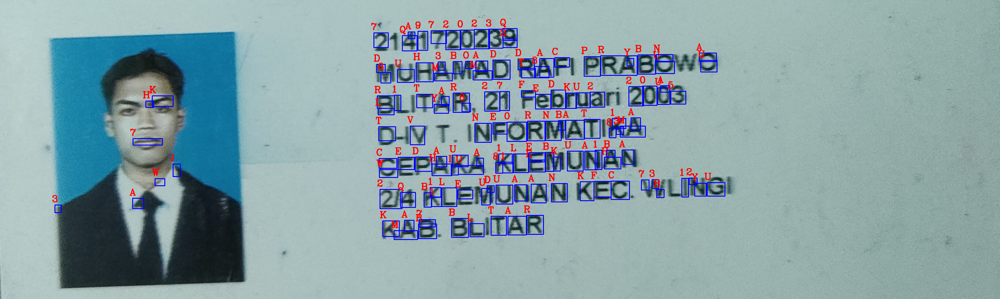

In [138]:
# Show char with actual image
img_copy2 = img.copy()

for(pred, (x, y, w, h)) in zip(preds, boxes):
  i = np.argmax(pred)
  char_detected = char_list[i]

  cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (255,0,0), 2)
  cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (0,0,255), 2)

cv2_imshow(img_copy2)

# KTM 4 RAFI

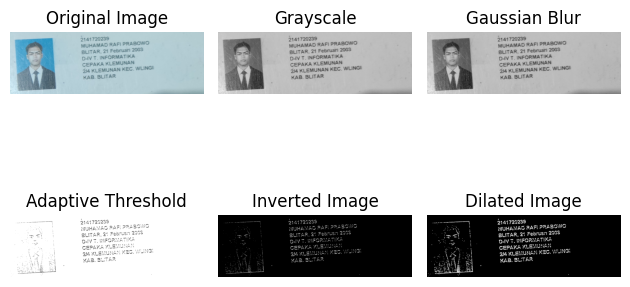

In [140]:
# Call the function with the image path
image_path = '/content/drive/MyDrive/SEMESTER5/PCVK/data/crop/3D_2141720239_4-MUHAMAD RAFI PRABOWO.jpg'
img, gray, dilation = preprocess_image(image_path)

In [141]:
# Define function for contour detection
def find_contours(img):
    conts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    conts = imutils.grab_contours(conts)
    conts = sort_contours(conts, method='left-to-right')[0]

    return conts

In [142]:
conts = find_contours(dilation.copy())

In [143]:
len(conts)

737

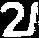

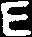

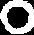

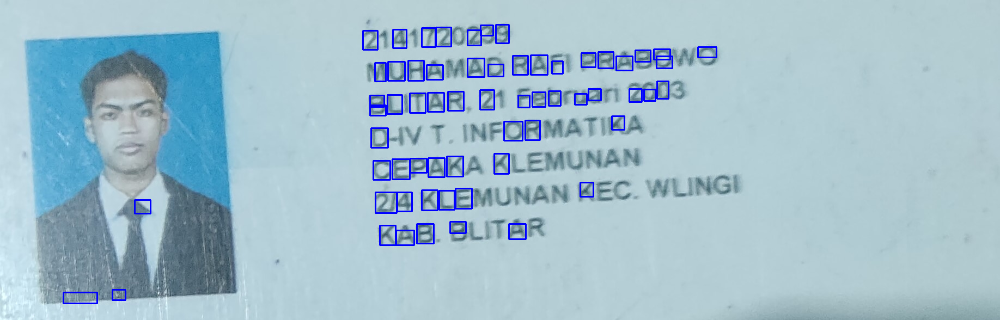

In [144]:
# Get the char based on contour


# Setup min/max width/hight for char
min_w, max_w = 17, 160
min_h, max_h = 19, 140
img_copy = img.copy() # original image for plotting countour result
filtered_conts = []

for c in conts:
  (x, y, w, h) = cv2.boundingRect(c) # find bounding box based on contour
  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h): # if pixel follow this rule, it consider as char
    filtered_conts.append(c)
    roi = gray[y:y+h, x:x+w] # get region of interest for char
    thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    cv2_imshow(thresh) # check

    # Build bounding box on original image
    cv2.rectangle(img_copy, (x,y), (x+w, y+h), (255,0,0), 2)

# Show bounding box on original image
cv2_imshow(img_copy)

In [145]:
def extract_roi(img, margin=2):
  roi = img[y - margin:y+h, x - margin:x + w + margin]
  return roi

# Thresholding
def thresholding(img):
  thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
  return thresh

# Resizing
def resize_img(img, w, h):
  if w > h:
    resized = imutils.resize(img, width=28)
  else:
    resized = imutils.resize(img, height=28)

  # (w, h) = resized.shape
  (h, w) = resized.shape

  # Calculate how many pixels need to fill char image
  dX = int(max(0, 28 - w) / 2.0)
  dY = int(max(0, 28 - h) / 2.0)

  filled = cv2.copyMakeBorder(resized, top=dY, bottom=dY, right=dX, left=dX, borderType=cv2.BORDER_CONSTANT, value=(0,0,0))
  filled = cv2.resize(filled, (28,28))

  return filled

In [146]:
# Demo for enlarge
(x, y, w, h) = cv2.boundingRect(filtered_conts[2])
test_image = thresholding(gray[y:y+h, x:x+w])

# show original test image
cv2_imshow(test_image)

# Show enlarge test image
cv2_imshow(cv2.resize(test_image, (28,28)))

In [147]:
(h, w) = test_image.shape

test_image2 = resize_img(test_image, w, h)

cv2_imshow(test_image)
cv2_imshow(test_image2)

In [148]:
def normalization(img):
  img = img.astype('float32') / 255.0 # convert to floating point
  img = np.expand_dims(img, axis=-1) # add depth
  return img

In [149]:
# Check
test_image2.shape, normalization(test_image2).shape

((28, 28), (28, 28, 1))

# DETECTION

In [150]:
def process_box(gray, x, y, w, h):

  roi = extract_roi(gray)
  thresh = thresholding(roi)
  (h, w) = thresh.shape
  resized = resize_img(thresh, w, h)

  # show result
  cv2_imshow(resized)

  normalized = normalization(resized)

  return (normalized, (x, y, w, h))

In [151]:
# Detect every single char from contour
detected_char = []

for c in conts:
  (x, y, w, h ) = cv2.boundingRect(c)

  min_w, max_w = 17, 160
  min_h, max_h = 19, 140

  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h):
    detected_char.append(process_box(gray, x, y, w, h))

In [152]:
detected_char[0][1]

(116, 537, 66, 22)

In [153]:
# Get all char pixel
pixels = np.array([px[0] for px in detected_char], dtype='float32')

# Get all box for detected char
boxes = [box[1] for box in detected_char]

In [154]:
pixels.shape

(62, 28, 28, 1)

# RECOGNIZE CHAR

In [155]:
digits = '0123456789'
letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
char_list = digits + letters
char_list = [ch for ch in char_list]

print(char_list)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']


In [156]:
save_path = '/content/drive/MyDrive/SEMESTER5/PCVK/dataset/model/network.h5'
load_network = load_model(save_path)

In [157]:
# Predict
preds = load_network.predict(pixels)

2/2 [==============================] - 1s 380ms/step


In [158]:
# Char Prediction
for p in preds:
  char_idx = np.argmax(p)
  print(char_list[char_idx], end = " ")

W B D 2 D Q D C A U K L N E 4 A 4 H T D B K T A A A 7 L K R Z E A L 2 2 U K 9 0 A R F A A E D K W E 2 2 7 1 A L 2 U A U O A 

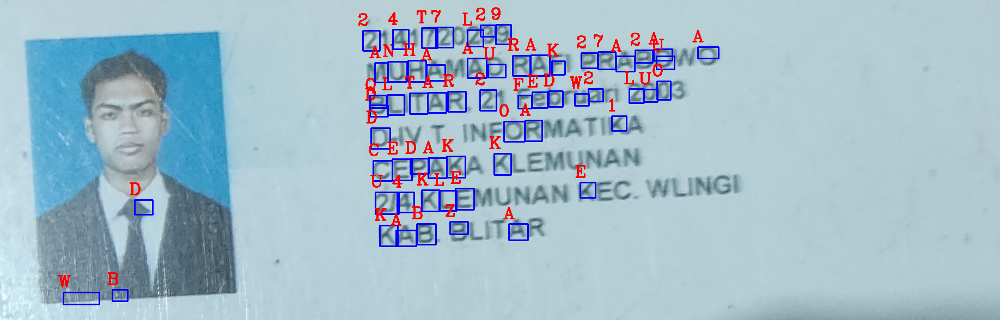

In [159]:
# Show char with actual image
img_copy2 = img.copy()

for(pred, (x, y, w, h)) in zip(preds, boxes):
  i = np.argmax(pred)
  char_detected = char_list[i]

  cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (255,0,0), 2)
  cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (0,0,255), 2)

cv2_imshow(img_copy2)

# KTM 5 RAFI

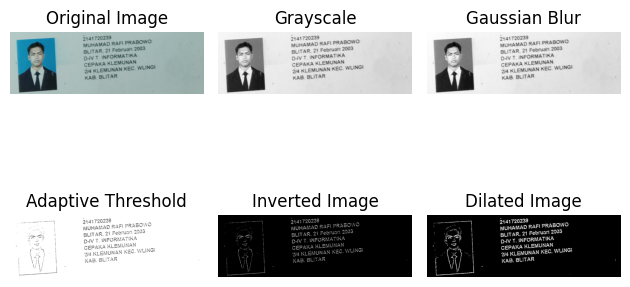

In [160]:
# Call the function with the image path
image_path = '/content/drive/MyDrive/SEMESTER5/PCVK/data/crop/3D_2141720239_5-MUHAMAD RAFI PRABOWO.jpg'
img, gray, dilation = preprocess_image(image_path)

In [161]:
# Define function for contour detection
def find_contours(img):
    conts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    conts = imutils.grab_contours(conts)
    conts = sort_contours(conts, method='left-to-right')[0]

    return conts

In [162]:
conts = find_contours(dilation.copy())

In [163]:
len(conts)

407

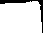

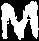

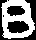

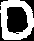

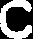

...

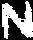

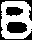

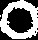

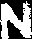

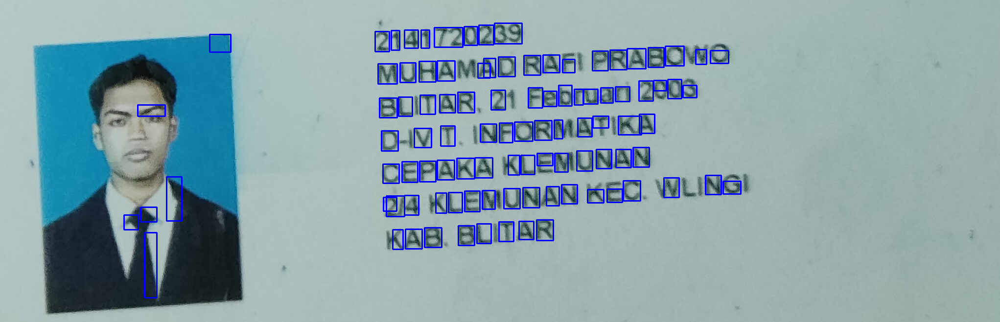

In [164]:
# Get the char based on contour


# Setup min/max width/hight for char
min_w, max_w = 17, 160
min_h, max_h = 19, 140
img_copy = img.copy() # original image for plotting countour result
filtered_conts = []

for c in conts:
  (x, y, w, h) = cv2.boundingRect(c) # find bounding box based on contour
  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h): # if pixel follow this rule, it consider as char
    filtered_conts.append(c)
    roi = gray[y:y+h, x:x+w] # get region of interest for char
    thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    cv2_imshow(thresh) # check

    # Build bounding box on original image
    cv2.rectangle(img_copy, (x,y), (x+w, y+h), (255,0,0), 2)

# Show bounding box on original image
cv2_imshow(img_copy)

In [165]:
def extract_roi(img, margin=2):
  roi = img[y - margin:y+h, x - margin:x + w + margin]
  return roi

# Thresholding
def thresholding(img):
  thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
  return thresh

# Resizing
def resize_img(img, w, h):
  if w > h:
    resized = imutils.resize(img, width=28)
  else:
    resized = imutils.resize(img, height=28)

  # (w, h) = resized.shape
  (h, w) = resized.shape

  # Calculate how many pixels need to fill char image
  dX = int(max(0, 28 - w) / 2.0)
  dY = int(max(0, 28 - h) / 2.0)

  filled = cv2.copyMakeBorder(resized, top=dY, bottom=dY, right=dX, left=dX, borderType=cv2.BORDER_CONSTANT, value=(0,0,0))
  filled = cv2.resize(filled, (28,28))

  return filled

In [166]:
# Demo for enlarge
(x, y, w, h) = cv2.boundingRect(filtered_conts[2])
test_image = thresholding(gray[y:y+h, x:x+w])

# show original test image
cv2_imshow(test_image)

# Show enlarge test image
cv2_imshow(cv2.resize(test_image, (28,28)))

In [167]:
(h, w) = test_image.shape

test_image2 = resize_img(test_image, w, h)

cv2_imshow(test_image)
cv2_imshow(test_image2)

In [168]:
def normalization(img):
  img = img.astype('float32') / 255.0 # convert to floating point
  img = np.expand_dims(img, axis=-1) # add depth
  return img

In [169]:
# Check
test_image2.shape, normalization(test_image2).shape

((28, 28), (28, 28, 1))

# DETECTION

In [170]:
def process_box(gray, x, y, w, h):

  roi = extract_roi(gray)
  thresh = thresholding(roi)
  (h, w) = thresh.shape
  resized = resize_img(thresh, w, h)

  # show result
  cv2_imshow(resized)

  normalized = normalization(resized)

  return (normalized, (x, y, w, h))

In [171]:
# Detect every single char from contour
detected_char = []

for c in conts:
  (x, y, w, h ) = cv2.boundingRect(c)

  min_w, max_w = 17, 160
  min_h, max_h = 19, 140

  if(w >= min_w and w <= max_w) and (h >= min_h and h <= max_h):
    detected_char.append(process_box(gray, x, y, w, h))

In [172]:
detected_char[0][1]

(253, 439, 33, 32)

In [173]:
# Get all char pixel
pixels = np.array([px[0] for px in detected_char], dtype='float32')

# Get all box for detected char
boxes = [box[1] for box in detected_char]

In [174]:
pixels.shape

(99, 28, 28, 1)

# RECOGNIZE CHAR

In [175]:
digits = '0123456789'
letters = 'ABCDEFGHIJKLMNOPQRSTUVWZYZ'
char_list = digits + letters
char_list = [ch for ch in char_list]

print(char_list)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'Z', 'Y', 'Z']


In [176]:
save_path = '/content/drive/MyDrive/SEMESTER5/PCVK/dataset/model/network.h5'
load_network = load_model(save_path)

In [177]:
# Predict
preds = load_network.predict(pixels)

4/4 [==============================] - 0s 9ms/step


In [178]:
# Char Prediction
for p in preds:
  char_idx = np.argmax(p)
  print(char_list[char_idx], end = " ")

R O D 1 Y D 2 N B D C 7 U 7 K L U E 4 Q A V H P T 9 B 7 K A A A T L K R 8 0 E A L B 2 N N A 2 3 D T F U 1 O A L N R F R R E A 8 A A N D N F F U A U A P T N 2 E R 7 A K C A N 2 A B 0 N 0 O S Y N U U 

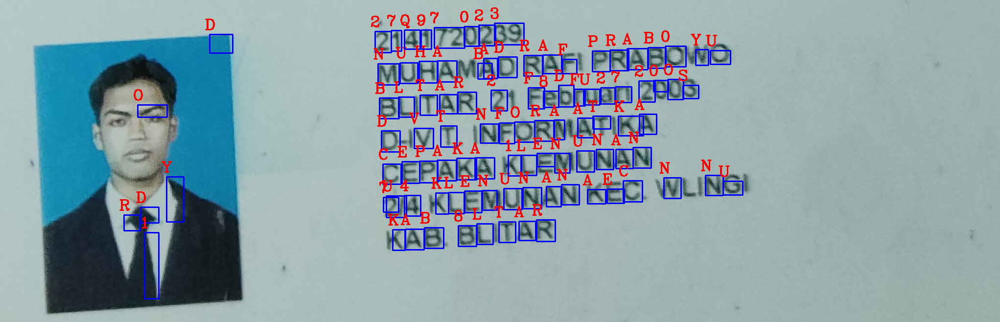

In [179]:
# Show char with actual image
img_copy2 = img.copy()

for(pred, (x, y, w, h)) in zip(preds, boxes):
  i = np.argmax(pred)
  char_detected = char_list[i]

  cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (255,0,0), 2)
  cv2.putText(img_copy2, char_detected, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (0,0,255), 2)

cv2_imshow(img_copy2)